Taken from https://docs.scvi-tools.org/en/stable/tutorials/notebooks/harmonization.html

In [1]:
import torch
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import scanpy as sc
import scvi

Global seed set to 0


In [320]:
sc.set_figure_params(dpi=100, frameon=False, color_map='Reds')
sc.logging.print_header()

scanpy==1.8.2 anndata==0.7.6 umap==0.5.2 numpy==1.20.3 scipy==1.5.3 pandas==1.3.4 scikit-learn==1.0.2 statsmodels==0.11.1 python-igraph==0.8.3 leidenalg==0.8.3 pynndescent==0.5.5


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/scanpy/_settings.py:447: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)


In [40]:
covid = sc.read('/storage/groups/ml01/workspace/yuge.ji/covid-perturbation/data/211001_annot_patient_integrated.h5ad')
covid

AnnData object with n_obs × n_vars = 300353 × 18115
    obs: 'identifier', 'patient', 'name', 'barcode_round', 'sample', 'viral_counts', 'treatment', 'treatment_virus', 'infected', 'n_counts', 'n_genes', 'percent_mito', 'percent_viral', 'leiden', 'final_bcs', 'batch', 'celltype_coarse', 'cell_type', 'infection_label', '_scvi_batch', '_scvi_labels', '_scvi_local_l_mean', '_scvi_local_l_var'
    var: 'used_for_scvi'
    uns: 'cell_type_colors', 'hvg', 'infected_colors', 'leiden', 'leiden_colors', 'neighbors', 'patient_colors', 'treatment_colors', 'umap'
    obsm: 'X_pca', 'X_scVI', 'X_umap'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [4]:
fischer = sc.read('/storage/groups/ml01/datasets/projects/20201130_Schober_TcellReversePhenotyping_meshal.ansari/201209_TcellReversePT_integrated.h5ad')
fischer.obs['cell_type'] = ['('.join(s.split('(')[:-1])[:-1] for s in fischer.obs['harmonized_celltype'].values]
fischer.obs['severity_virus'] = fischer.obs.severity.astype(str) + '_' + fischer.obs.virus_positive.astype(str)
fischer

AnnData object with n_obs × n_vars = 279663 × 46190
    obs: 'patients', 'sample_ID', 'data_set', 'severity', 'location', 'condition', 'age', 'sex', 'virus_positive', 'PBMC_leiden_29', 'patient_category', 'reactive_clonotype', 'published_meta_celltype', 'published_celltype', 'harmonized_celltype', 'T_cell_type', 'size_factors', 'pct_mitochondrial', 'n_counts', 'n_genes', 'cell_type'
    var: 'highly_variable'
    uns: 'PBMC_leiden_29_colors', 'T_cell_type_colors', 'condition_colors', 'data_set_colors', 'harmonized_celltype_colors', 'leiden_colors', 'location_colors', 'name_colors', 'neighbors', 'patient_category_colors', 'patient_colors', 'patients_colors', 'pca', 'published_celltype_colors', 'reactive_colors', 'sample_colors', 'second_harmonized_colors', 'severity_TA_colors', 'severity_colors', 'severity_condition_colors', 'umap', 'virus_positive_colors'
    obsm: 'X_clonotype_network', 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts', 'unsouped_counts'
    obsp: 'connectivities

## Filter data and harmonize labels

Remove cells without a treatment label and subsample to decrease runtime. Only use patient 4 to reduce complexity.

In [128]:
covid = covid[covid.obs.patient == 'patient_4']
covid = covid[(covid.obs.treatment != 'nan') & (covid.obs.infected == 'False')]
covid

View of AnnData object with n_obs × n_vars = 37585 × 18115
    obs: 'identifier', 'patient', 'name', 'barcode_round', 'sample', 'viral_counts', 'treatment', 'treatment_virus', 'infected', 'n_counts', 'n_genes', 'percent_mito', 'percent_viral', 'leiden', 'final_bcs', 'batch', 'celltype_coarse', 'cell_type', 'infection_label', '_scvi_batch', '_scvi_labels', '_scvi_local_l_mean', '_scvi_local_l_var', 'batch_data'
    var: 'used_for_scvi'
    uns: 'cell_type_colors', 'hvg', 'infected_colors', 'leiden', 'leiden_colors', 'neighbors', 'patient_colors', 'treatment_colors', 'umap'
    obsm: 'X_pca', 'X_scVI', 'X_umap'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

Subset fischer to epithelial celltypes.

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'cell_type' as categorical


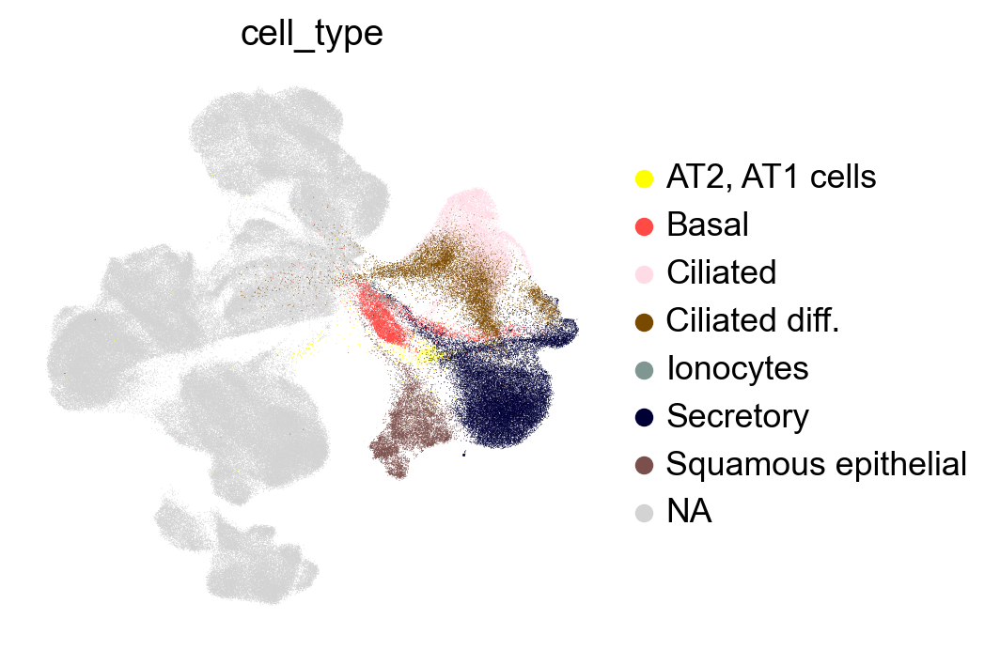

In [6]:
sc.pl.umap(
    fischer, 
    color='cell_type',
    groups=['Ciliated', 'Ciliated diff.', 'Basal', 'Ionocytes', 'Squamous epithelial', 'Secretory', 'AT2, AT1 cells']
)

In [7]:
fischer = fischer[fischer.obs.cell_type.isin(['Ciliated', 'Ciliated diff.', 'Basal', 'Ionocytes', 'Squamous epithelial', 'Secretory', 'AT2, AT1 cells'])]
fischer

View of AnnData object with n_obs × n_vars = 62326 × 46190
    obs: 'patients', 'sample_ID', 'data_set', 'severity', 'location', 'condition', 'age', 'sex', 'virus_positive', 'PBMC_leiden_29', 'patient_category', 'reactive_clonotype', 'published_meta_celltype', 'published_celltype', 'harmonized_celltype', 'T_cell_type', 'size_factors', 'pct_mitochondrial', 'n_counts', 'n_genes', 'cell_type'
    var: 'highly_variable'
    uns: 'PBMC_leiden_29_colors', 'T_cell_type_colors', 'condition_colors', 'data_set_colors', 'harmonized_celltype_colors', 'leiden_colors', 'location_colors', 'name_colors', 'neighbors', 'patient_category_colors', 'patient_colors', 'patients_colors', 'pca', 'published_celltype_colors', 'reactive_colors', 'sample_colors', 'second_harmonized_colors', 'severity_TA_colors', 'severity_colors', 'severity_condition_colors', 'umap', 'virus_positive_colors', 'cell_type_colors'
    obsm: 'X_clonotype_network', 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts', 'unsouped_counts

In [ ]:
sc.pl.umap(fischer, color=['severity', 'virus_positive'])

Harmonized cell type names.

In [9]:
fischer.obs['cell_type'] = [s.lower() for s in fischer.obs['cell_type']]

Trying to set attribute `.obs` of view, copying.


Label batches.

In [43]:
fischer.obs['batch_data'] = 'fischer'
covid.obs['batch_data'] = covid.obs['patient']

Trying to set attribute `.obs` of view, copying.


#### Take a peek

In [129]:
pd.crosstab(covid.obs.treatment, covid.obs.cell_type)

cell_type,basal,ciliated,club,goblet,ionocytes
treatment,,,,,
BB94,743,101,887,4,3
Gilteritinib,878,95,979,1,3
IFNL,1377,133,1439,1,3
IFNa (b_d),990,85,1144,2,9
IFNa_TNFa,665,153,1033,2,5
IFNg,1012,118,1196,2,7
IFNg_TGFb2,990,109,922,1,1
Sorafenib,1624,157,1374,2,2
TGFb2,1144,114,1191,1,3


## Combine data

In [350]:
adata = covid.concatenate(fischer)
adata

AnnData object with n_obs × n_vars = 99911 × 18023
    obs: 'identifier', 'patient', 'name', 'barcode_round', 'sample', 'viral_counts', 'treatment', 'treatment_virus', 'infected', 'n_counts', 'n_genes', 'percent_mito', 'percent_viral', 'leiden', 'final_bcs', 'batch', 'celltype_coarse', 'cell_type', 'infection_label', '_scvi_batch', '_scvi_labels', '_scvi_local_l_mean', '_scvi_local_l_var', 'batch_data', 'patients', 'sample_ID', 'data_set', 'severity', 'location', 'condition', 'age', 'sex', 'virus_positive', 'PBMC_leiden_29', 'patient_category', 'reactive_clonotype', 'published_meta_celltype', 'published_celltype', 'harmonized_celltype', 'T_cell_type', 'size_factors', 'pct_mitochondrial', 'severity_virus'
    var: 'used_for_scvi-0', 'highly_variable-1'
    obsm: 'X_pca', 'X_umap'
    layers: 'counts'

In [351]:
adata.X = adata.layers['counts']
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
adata

AnnData object with n_obs × n_vars = 99911 × 18023
    obs: 'identifier', 'patient', 'name', 'barcode_round', 'sample', 'viral_counts', 'treatment', 'treatment_virus', 'infected', 'n_counts', 'n_genes', 'percent_mito', 'percent_viral', 'leiden', 'final_bcs', 'batch', 'celltype_coarse', 'cell_type', 'infection_label', '_scvi_batch', '_scvi_labels', '_scvi_local_l_mean', '_scvi_local_l_var', 'batch_data', 'patients', 'sample_ID', 'data_set', 'severity', 'location', 'condition', 'age', 'sex', 'virus_positive', 'PBMC_leiden_29', 'patient_category', 'reactive_clonotype', 'published_meta_celltype', 'published_celltype', 'harmonized_celltype', 'T_cell_type', 'size_factors', 'pct_mitochondrial', 'severity_virus'
    var: 'used_for_scvi-0', 'highly_variable-1'
    uns: 'log1p'
    obsm: 'X_pca', 'X_umap'
    layers: 'counts'

## integrate with scvi across full gene set

In [46]:
# subsample for speed
sc.pp.subsample(adata, .2)

In [20]:
scvi.model.SCVI.setup_anndata(adata, layer="counts", batch_key="batch_data")

INFO     Using batches from adata.obs["batch_data"]                                          
INFO     No label_key inputted, assuming all cells have same label                           
INFO     Using data from adata.layers["counts"]                                              
INFO     Successfully registered anndata object containing 26790 cells, 18023 vars, 2        
         batches, 1 labels, and 0 proteins. Also registered 0 extra categorical covariates   
         and 0 extra continuous covariates.                                                  
INFO     Please do not further modify adata until model is trained.                          


In [21]:
arches_params = dict(
    use_layer_norm="both",
    use_batch_norm="none",
    encode_covariates=True,
    dropout_rate=0.2,
    n_layers=2,
    n_latent=30,
)

vae_ref = scvi.model.SCVI(
    adata,
    **arches_params
)
vae_ref.train(early_stopping=True, max_epochs=5)

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/scvi/model/base/_base_model.py:151: UserWarning: Make sure the registered X field in anndata contains unnormalized count data.
  "Make sure the registered X field in anndata contains unnormalized count data."
GPU available: False, used: False
TPU available: False, using: 0 TPU cores


Epoch 1/5:   0%|                                                                                                                                                                                                                      | 0/5 [00:00<?, ?it/s]

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/scvi/distributions/_negative_binomial.py:435: UserWarning: The value argument must be within the support of the distribution
  UserWarning,


Epoch 5/5: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:47<00:00,  9.46s/it, loss=4.66e+03, v_num=1]


In [22]:
adata.obsm["X_scVI"] = vae_ref.get_latent_representation()

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/scvi/model/base/_base_model.py:151: UserWarning: Make sure the registered X field in anndata contains unnormalized count data.
  "Make sure the registered X field in anndata contains unnormalized count data."


In [23]:
%%time
sc.pp.neighbors(adata, use_rep="X_scVI")
sc.tl.umap(adata)

Epoch 1/5:   0%|                                                                                                                                                                                                                      | 0/5 [02:00<?, ?it/s]
CPU times: user 1min 7s, sys: 16 s, total: 1min 23s
Wall time: 39.7 s


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'cell_type' as categorical
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch_data' as categorical


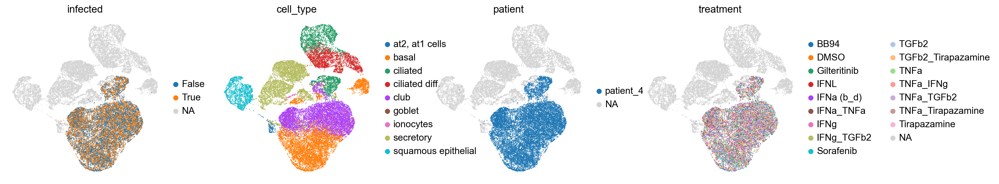

In [25]:
sc.pl.umap(adata, color=['infected', 'cell_type', 'patient', 'treatment'])

## integrate over scvi with top 5000 highly variable genes, by batch

In [28]:
sc.pp.highly_variable_genes(
    adata,
    n_top_genes=5000,
    batch_key="batch_data",
    subset=True
)

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'cell_type' as categorical
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch_data' as categorical
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the 

In [29]:
# subsample for speed
sc.pp.subsample(adata, .2)

In [30]:
scvi.model.SCVI.setup_anndata(adata, layer="counts", batch_key="batch_data")

INFO     Using batches from adata.obs["batch_data"]                                          
INFO     No label_key inputted, assuming all cells have same label                           
INFO     Using data from adata.layers["counts"]                                              
INFO     Successfully registered anndata object containing 26790 cells, 5000 vars, 2 batches,
         1 labels, and 0 proteins. Also registered 0 extra categorical covariates and 0 extra
         continuous covariates.                                                              
INFO     Please do not further modify adata until model is trained.                          


In [31]:
arches_params = dict(
    use_layer_norm="both",
    use_batch_norm="none",
    encode_covariates=True,
    dropout_rate=0.2,
    n_layers=2,
    n_latent=30,
)

vae_ref = scvi.model.SCVI(
    adata,
    **arches_params
)
vae_ref.train(early_stopping=True, max_epochs=5)

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/scvi/model/base/_base_model.py:151: UserWarning: Make sure the registered X field in anndata contains unnormalized count data.
  "Make sure the registered X field in anndata contains unnormalized count data."
GPU available: False, used: False
TPU available: False, using: 0 TPU cores


Epoch 1/5:   0%|                                                                                                                                                                                                                      | 0/5 [00:00<?, ?it/s]

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/scvi/distributions/_negative_binomial.py:435: UserWarning: The value argument must be within the support of the distribution
  UserWarning,


Epoch 5/5: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:24<00:00,  4.88s/it, loss=1e+03, v_num=1]


In [32]:
adata.obsm["X_scVI"] = vae_ref.get_latent_representation()

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/scvi/model/base/_base_model.py:151: UserWarning: Make sure the registered X field in anndata contains unnormalized count data.
  "Make sure the registered X field in anndata contains unnormalized count data."


In [33]:
%%time
sc.pp.neighbors(adata, use_rep="X_scVI")
sc.tl.umap(adata)

CPU times: user 52.3 s, sys: 16.4 s, total: 1min 8s
Wall time: 23.4 s


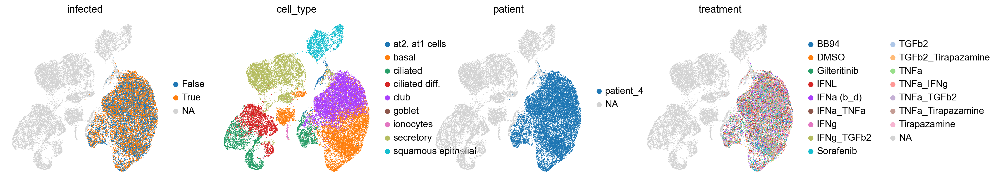

In [34]:
sc.pl.umap(adata, color=['infected', 'cell_type', 'patient', 'treatment'])

Okay, so brute forcing it is clearly not working. But we know scvi is capable of correcting out actual batch effect, so whatever the difference here is, it must be biological. With that in mind:

## learning responses manually with a linear classifier

In [130]:
from sklearn.linear_model import LogisticRegression

In [131]:
%%time
clf = LogisticRegression(solver='saga')

subset = adata[adata.obs.treatment.isin(['IFNL', 'mock'])]
clf.fit(subset.X.toarray(), subset.obs.treatment.values)
clf.classes_

CPU times: user 4min 42s, sys: 5.67 s, total: 4min 48s
Wall time: 4min 48s


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/sklearn/linear_model/_sag.py:354: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  ConvergenceWarning,


array(['IFNL', 'mock'], dtype=object)

In [165]:
adata.obs['IFNL_score'] = clf.predict_proba(adata.X.toarray())[:, 0]
adata.obs['not_IFNL_score'] = clf.predict_proba(adata.X.toarray())[:, 1]
adata.obs['IFNL_score'][adata.obs['IFNL_score'] < .2] = 0  # to help with dotplot
adata.obs['not_IFNL_score'][adata.obs['not_IFNL_score'] < .2] = 0  # to help with dotplot
adata.obs['IFNL_decision_fn'] = clf.decision_function(adata.X.toarray())

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


Let's see how well IFNL markers come through. We would expect a strong IFNL signal only in the infected individuals.

In [166]:
adata.obs.severity_virus.value_counts()

mild_non-infected       30426
severe_non-infected     29327
healthy_non-infected     2266
severe_infected           281
mild_infected              26
Name: severity_virus, dtype: int64

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'cell_type' as categorical
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'batch_data' as categorical


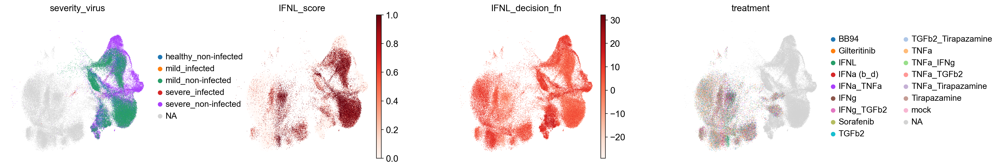

In [167]:
sc.pl.umap(adata, color=['severity_virus', 'IFNL_score', 'IFNL_decision_fn', 'treatment'], wspace=.4)

Check the distribution of IFNL scores - is it the same as in our original dataset?

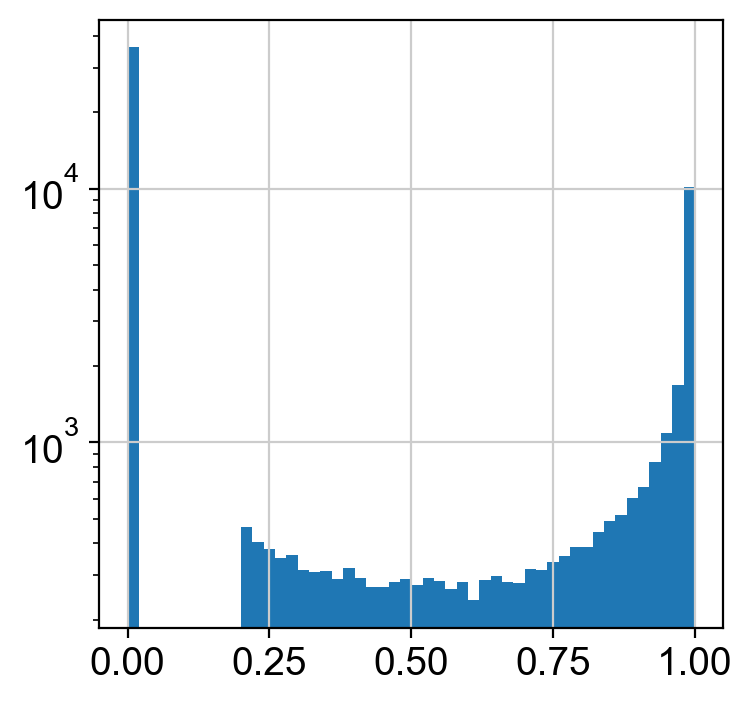

In [135]:
plt.hist(adata[adata.obs.batch_data == 'fischer'].obs.IFNL_score.values, bins=50)
plt.yscale('log')

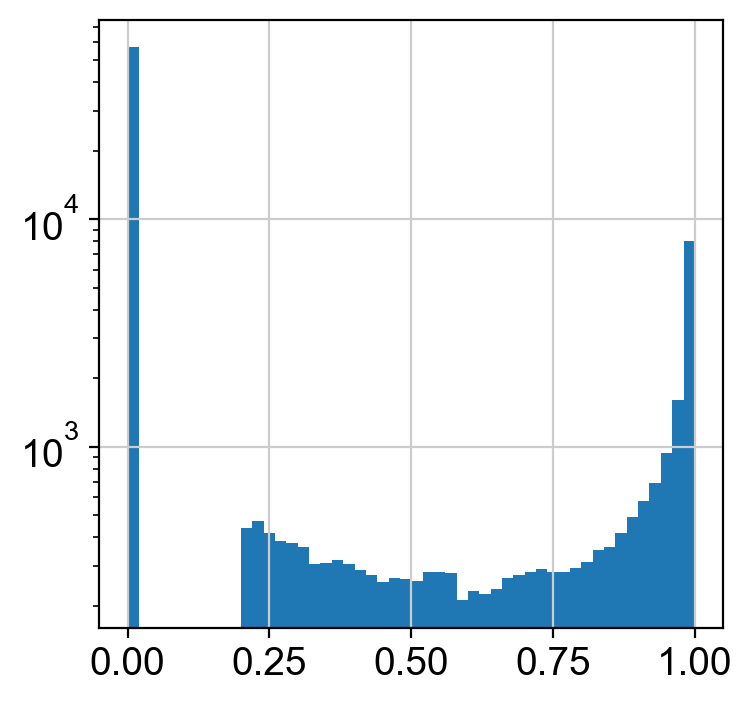

In [136]:
plt.hist(adata[adata.obs.batch_data == 'patient_4'].obs.IFNL_score.values, bins=50)
plt.yscale('log')

Just to check, is this signal merely patient specific? Number of patients per condition:

In [137]:
pd.crosstab(adata.obs.patients, adata.obs.severity_virus).astype(bool).sum(axis=0)

severity_virus
healthy_non-infected     8
mild_infected            5
mild_non-infected       11
severe_infected         14
severe_non-infected     31
dtype: int64

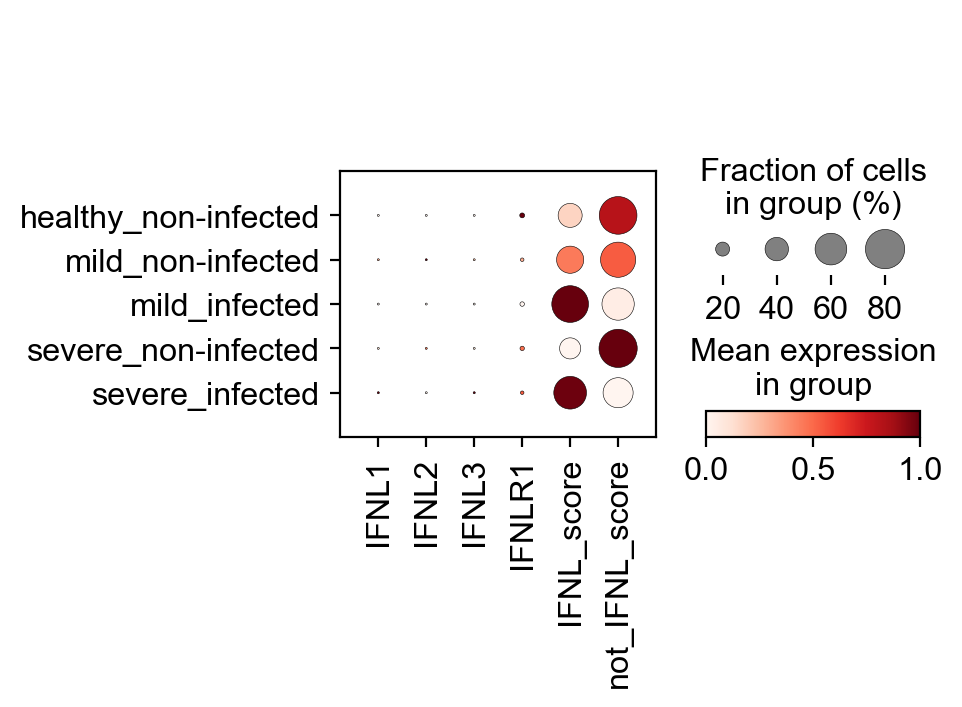

In [138]:
sc.pl.dotplot(
    adata[adata.obs.batch_data == 'fischer'],
    var_names=['IFNL1', 'IFNL2', 'IFNL3', 'IFNLR1', 'IFNL_score', 'not_IFNL_score'],
    groupby=['severity', 'virus_positive'], standard_scale='var', smallest_dot=.5)

Since that worked, let's see if we can achieve the same effect by subsetting to IFNL genes.

## scANVI label transfer without gene subset

In [192]:
sc.pp.highly_variable_genes(
    adata,
    n_top_genes=5000,
    batch_key="batch_data"
)

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)


Set unknown label.

In [193]:
adata.obs["treatment_scanvi"] = 'Unknown'
fischer_idx = adata.obs['batch_data'] != "fischer"
adata.obs["treatment_scanvi"][fischer_idx] = adata.obs.treatment[fischer_idx]

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [194]:
scvi.model.SCANVI.setup_anndata(
    adata,
    layer="counts",
    batch_key="batch_data",
    labels_key="treatment_scanvi",
)

INFO     Using batches from adata.obs["batch_data"]                                          
INFO     Using labels from adata.obs["treatment_scanvi"]                                     
INFO     Using data from adata.layers["counts"]                                              
INFO     Successfully registered anndata object containing 99911 cells, 18023 vars, 2        
         batches, 17 labels, and 0 proteins. Also registered 0 extra categorical covariates  
         and 0 extra continuous covariates.                                                  
INFO     Please do not further modify adata until model is trained.                          


In [156]:
arches_params = dict(
    use_layer_norm="both",
    use_batch_norm="none",
    encode_covariates=True,
    dropout_rate=0.2,
    n_layers=2,
    n_latent=30,
)

lvae = scvi.model.SCANVI(adata, "Unknown", **arches_params)
lvae.train(early_stopping=True, max_epochs=20)

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/scvi/model/base/_base_model.py:151: UserWarning: Make sure the registered X field in anndata contains unnormalized count data.
  "Make sure the registered X field in anndata contains unnormalized count data."


INFO     Training for 20 epochs.                                                             


GPU available: False, used: False
TPU available: False, using: 0 TPU cores


Epoch 1/20:   0%|                                                                                                                                                                                                                    | 0/20 [00:00<?, ?it/s]

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/scvi/distributions/_negative_binomial.py:435: UserWarning: The value argument must be within the support of the distribution
  UserWarning,


Epoch 20/20: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [17:01<00:00, 51.05s/it, loss=4.32e+03, v_num=1]


#### Predict

In [195]:
adata.obs["treatment_predicted"] = lvae.predict(adata)
adata.obsm["X_scANVI"] = lvae.get_latent_representation(adata)

INFO     Using data from adata.layers["counts"]                                              


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/scvi/model/base/_base_model.py:151: UserWarning: Make sure the registered X field in anndata contains unnormalized count data.
  "Make sure the registered X field in anndata contains unnormalized count data."
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/scvi/data/_anndata.py:1234: UserWarning: Categorical encoding for label is similar but not equal between the anndata used to train and the anndata passed in. Will attempt transfer. Expected categories: ['BB94' 'Gilteritinib' 'IFNL' 'IFNa (b_d)' 'IFNa_TNFa' 'IFNg' 'IFNg_TGFb2'
 'Sorafenib' 'TGFb2' 'TGFb2_Tirapazamine' 'TNFa' 'TNFa_IFNg' 'TNFa_TGFb2'
 'TNFa_Tirapazamine' 'Tirapazamine' 'mock' 'Unknown']. Received categories: ['BB94' 'Gilteritinib' 'IFNL' 'IFNa (b_d)' 'IFNa_TNFa' 'IFNg' 'IFNg_TGFb2'
 'Sorafenib' 'TGFb2' 'TGFb2_Tirapazamine' 'TNFa' 'TNFa_IFNg' 'TNFa_TGFb2'
 'TNFa_Tirapazamine' 'Tirapazamine' 'Unknown' 'mock'].
 
  warnings.warn(warning_

INFO     Registered keys:['X', 'batch_indices', 'labels']                                    
INFO     Successfully registered anndata object containing 99911 cells, 18023 vars, 2        
         batches, 17 labels, and 0 proteins. Also registered 0 extra categorical covariates  
         and 0 extra continuous covariates.                                                  


In [196]:
%%time
sc.pp.neighbors(adata, use_rep="X_scANVI")
sc.tl.umap(adata)

CPU times: user 5min 29s, sys: 1min 13s, total: 6min 43s
Wall time: 1min 38s


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'treatment_scanvi' as categorical
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'treatment_predicted' as categorical


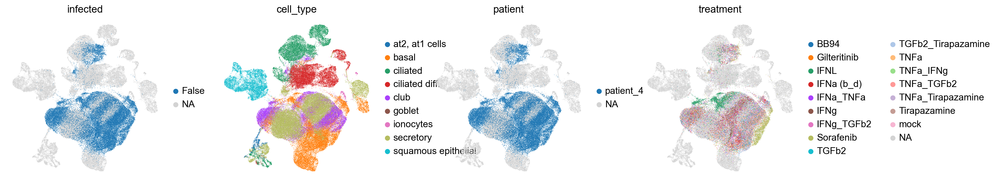

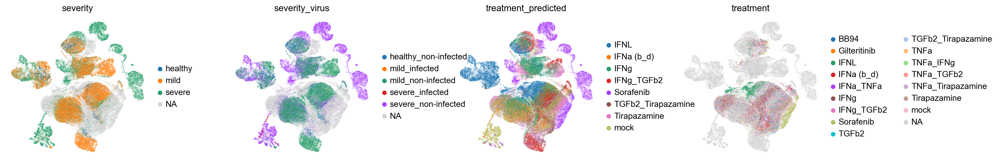

In [197]:
sc.pl.umap(adata, color=['infected', 'cell_type', 'patient', 'treatment'])
sc.pl.umap(adata, color=['severity', 'severity_virus', 'treatment_predicted', 'treatment'], wspace=.4)

<AxesSubplot:xlabel='severity_virus', ylabel='treatment_predicted'>

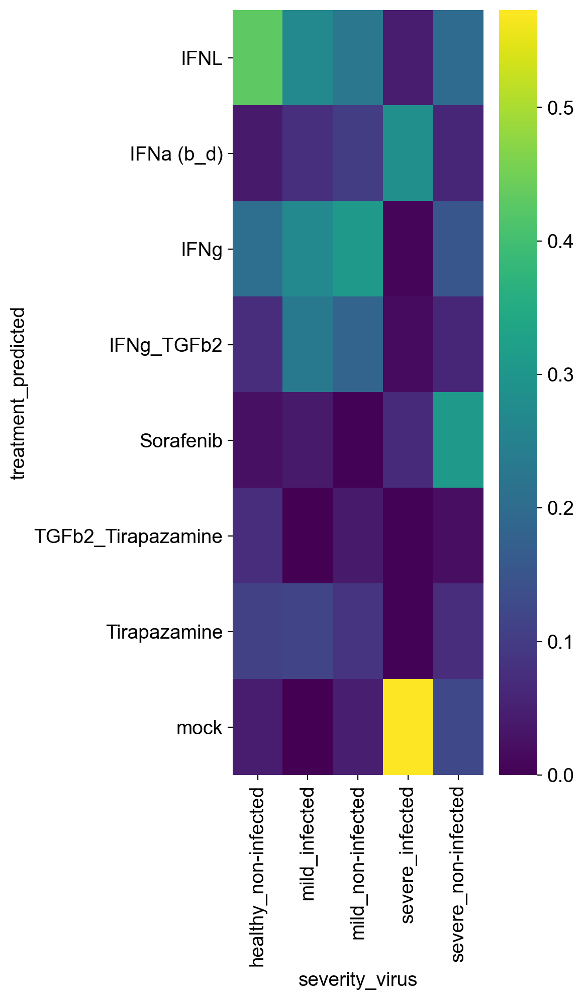

In [200]:
# normalized on columns
df = adata.obs.groupby(["severity_virus", "treatment_predicted"]).size().unstack(fill_value=0).T
df = df / df.sum(axis=0)
plt.figure(figsize=(4, 10))
sns.heatmap(df, cmap='viridis')

In [ ]:
# for i in range(preds.shape[1]):
#     adata.obs[f'classifier_proba_{adata.obs.treatment.cat.categories[i]}'] = preds[:, i]

# sc.pl.matrixplot(
#     adata[adata.obs.batch_data == 'fischer'],
#     groupby=['severity_virus', 'cell_type'],
#     var_names=[f'classifier_proba_{adata.obs.treatment.cat.categories[i]}' for i in range(preds.shape[1])],
#     swap_axes=True
# )

Hmmm.... that's... not right...

## scanvi label transfer with gene subset

Instead of training and trying to integrate on highly variable genes, we'll instead subset the data to the set of genes which were the strongest markers for IFNL.

-0.08601207807660102

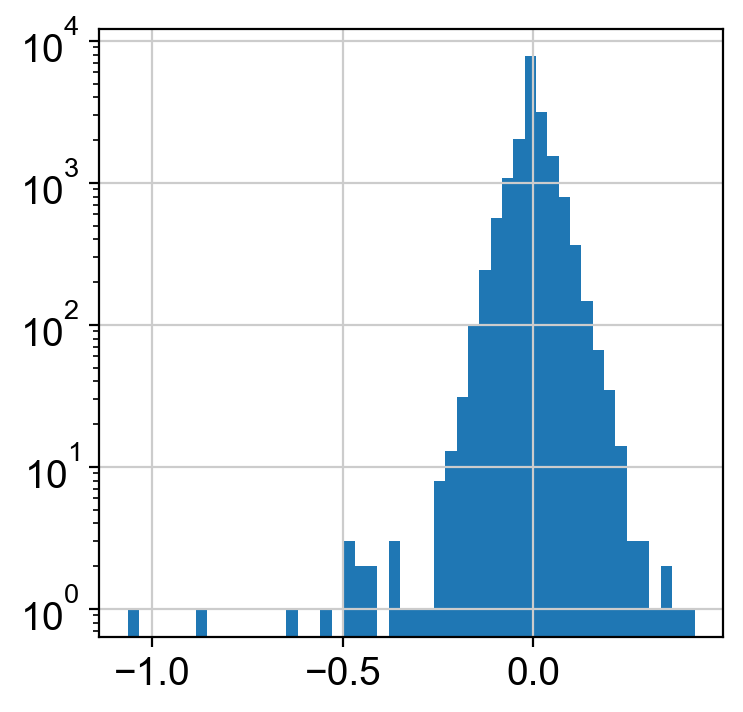

In [203]:
plt.hist(clf.coef_[0], bins=50)

upper = np.quantile(clf.coef_[0], .86)  # to reach approximately 5000 genes
lower = np.quantile(clf.coef_[0], .14)
plt.axvline(upper)
plt.axvline(lower)

plt.yscale('log')

np.quantile(clf.coef_[0], .05)

In [378]:
adata.var['coef'] = clf.coef_[0]
adata.var['marker_genes'] = [v < lower or v > upper for v in clf.coef_[0]]

In [380]:
adata.var['marker_genes'].value_counts()

False    12975
True      5048
Name: marker_genes, dtype: int64

Subset.

In [381]:
adata = adata[:, adata.var['marker_genes'] == True]
adata

View of AnnData object with n_obs × n_vars = 99911 × 5048
    obs: 'identifier', 'patient', 'name', 'barcode_round', 'sample', 'viral_counts', 'treatment', 'treatment_virus', 'infected', 'n_counts', 'n_genes', 'percent_mito', 'percent_viral', 'leiden', 'final_bcs', 'batch', 'celltype_coarse', 'cell_type', 'infection_label', '_scvi_batch', '_scvi_labels', '_scvi_local_l_mean', '_scvi_local_l_var', 'batch_data', 'patients', 'sample_ID', 'data_set', 'severity', 'location', 'condition', 'age', 'sex', 'virus_positive', 'PBMC_leiden_29', 'patient_category', 'reactive_clonotype', 'published_meta_celltype', 'published_celltype', 'harmonized_celltype', 'T_cell_type', 'size_factors', 'pct_mitochondrial', 'severity_virus'
    var: 'used_for_scvi-0', 'highly_variable-1', 'coef', 'marker_genes'
    uns: 'log1p'
    obsm: 'X_pca', 'X_umap'
    layers: 'counts'

Train.

In [388]:
# set unknown label
adata.obs["treatment_scanvi"] = 'Unknown'
fischer_idx = adata.obs['batch_data'] != "fischer"
adata.obs["treatment_scanvi"][fischer_idx] = adata.obs.treatment[fischer_idx]

Trying to set attribute `.obs` of view, copying.
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.


In [389]:
scvi.model.SCANVI.setup_anndata(
    adata,
    layer="counts",
    batch_key="batch_data",
    labels_key="treatment_scanvi",
)

INFO     Using batches from adata.obs["batch_data"]                                          


INFO:scvi.data._anndata:Using batches from adata.obs["batch_data"]


INFO     Using labels from adata.obs["treatment_scanvi"]                                     


INFO:scvi.data._anndata:Using labels from adata.obs["treatment_scanvi"]


INFO     Using data from adata.layers["counts"]                                              


INFO:scvi.data._anndata:Using data from adata.layers["counts"]


INFO     Successfully registered anndata object containing 99911 cells, 5048 vars, 2 batches,
         17 labels, and 0 proteins. Also registered 0 extra categorical covariates and 0     
         extra continuous covariates.                                                        


INFO:scvi.data._anndata:Successfully registered anndata object containing 99911 cells, 5048 vars, 2 batches, 17 labels, and 0 proteins. Also registered 0 extra categorical covariates and 0 extra continuous covariates.


INFO     Please do not further modify adata until model is trained.                          


INFO:scvi.data._anndata:Please do not further modify adata until model is trained.


In [ ]:
arches_params = dict(
    use_layer_norm="both",
    use_batch_norm="none",
    encode_covariates=True,
    dropout_rate=0.2,
    n_layers=2,
    n_latent=30,
)

lvae_lr = scvi.model.SCANVI(adata, "Unknown", **arches_params)
lvae_lr.train(early_stopping=True, max_epochs=20)

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/scvi/model/base/_base_model.py:151: UserWarning: Make sure the registered X field in anndata contains unnormalized count data.
  "Make sure the registered X field in anndata contains unnormalized count data."


INFO     Training for 20 epochs.                                                             


GPU available: False, used: False
TPU available: False, using: 0 TPU cores


Epoch 1/20:   0%|                                                                                                                                                                                                                    | 0/20 [00:00<?, ?it/s]

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/scvi/distributions/_negative_binomial.py:435: UserWarning: The value argument must be within the support of the distribution
  UserWarning,


Epoch 2/20:   5%|█████████                                                                                                                                                                           | 1/20 [00:35<10:40, 33.73s/it, loss=2.41e+03, v_num=1]

In [223]:
lvae_lr.module

SCANVAE(
  (z_encoder): Encoder(
    (encoder): FCLayers(
      (fc_layers): Sequential(
        (Layer 0): Sequential(
          (0): Linear(in_features=5050, out_features=128, bias=True)
          (1): None
          (2): LayerNorm((128,), eps=1e-05, elementwise_affine=False)
          (3): ReLU()
          (4): Dropout(p=0.2, inplace=False)
        )
        (Layer 1): Sequential(
          (0): Linear(in_features=130, out_features=128, bias=True)
          (1): None
          (2): LayerNorm((128,), eps=1e-05, elementwise_affine=False)
          (3): ReLU()
          (4): Dropout(p=0.2, inplace=False)
        )
      )
    )
    (mean_encoder): Linear(in_features=128, out_features=30, bias=True)
    (var_encoder): Linear(in_features=128, out_features=30, bias=True)
  )
  (l_encoder): Encoder(
    (encoder): FCLayers(
      (fc_layers): Sequential(
        (Layer 0): Sequential(
          (0): Linear(in_features=5050, out_features=128, bias=True)
          (1): None
          (2): La

Save the model.

In [226]:
lvae_lr.save('2022-03-20_scanvi_IFNL_genes_fischer_map', overwrite=True, save_anndata=True)

### Predict

In [215]:
adata.obs["treatment_predicted"] = lvae_lr.predict(adata)
adata.obsm["X_scANVI"] = lvae_lr.get_latent_representation(adata)

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/scvi/model/base/_base_model.py:151: UserWarning: Make sure the registered X field in anndata contains unnormalized count data.
  "Make sure the registered X field in anndata contains unnormalized count data."


In [216]:
%%time
sc.pp.neighbors(adata, use_rep="X_scANVI")
sc.tl.umap(adata)

CPU times: user 3min 28s, sys: 1min 11s, total: 4min 40s
Wall time: 1min 30s


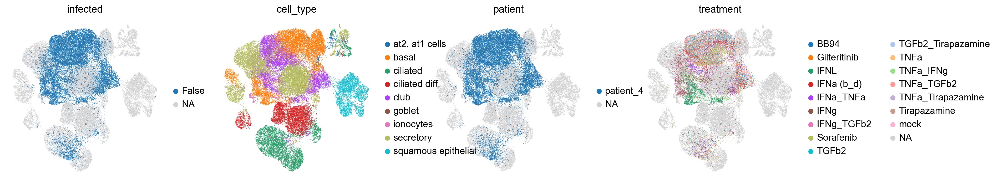

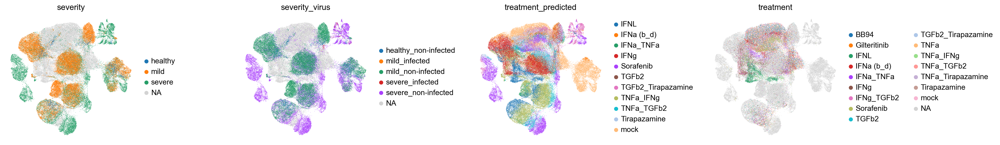

In [297]:
sc.pl.umap(adata, color=['batch_data', 'treatment', 'cell_type'])
sc.pl.umap(adata, color=['severity', 'severity_virus', 'treatment_predicted', 'treatment'], wspace=.6)

<AxesSubplot:xlabel='severity_virus', ylabel='treatment_predicted'>

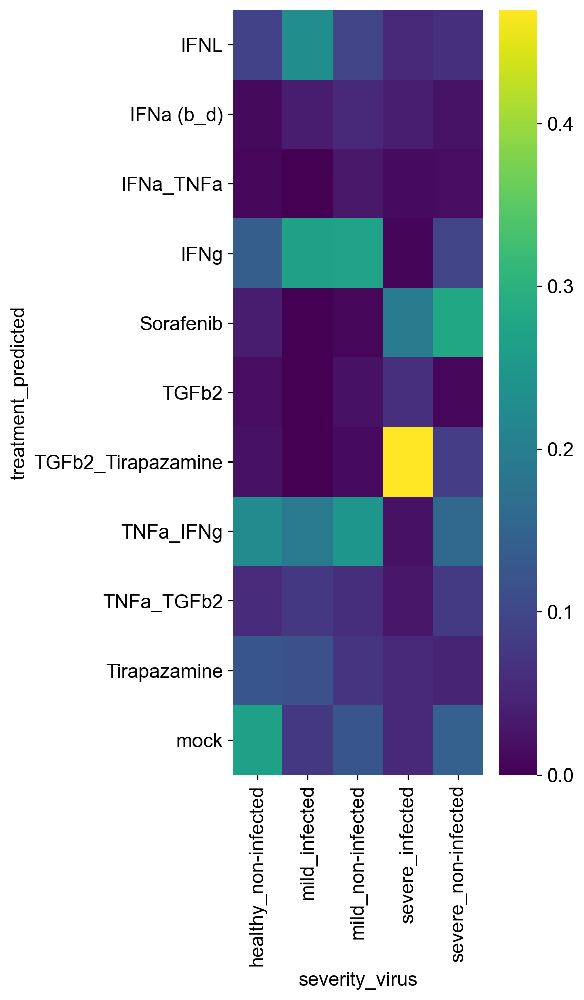

In [218]:
# normalized on columns
df = adata.obs.groupby(["severity_virus", "treatment_predicted"]).size().unstack(fill_value=0).T
df = df / df.sum(axis=0)
plt.figure(figsize=(4, 10))
sns.heatmap(df, cmap='viridis')

These labels make a LOT more sense, and all from subsetting to IFNL marker genes as determined by a logistic regression.

We'll now try to get a better interpretation by using the probabilities directly.

### Predict proba

In [254]:
z1 = lvae_lr.get_latent_representation()
preds = lvae_lr.module.classifier(torch.from_numpy(z1)).detach().numpy()
preds.shape

(99911, 16)

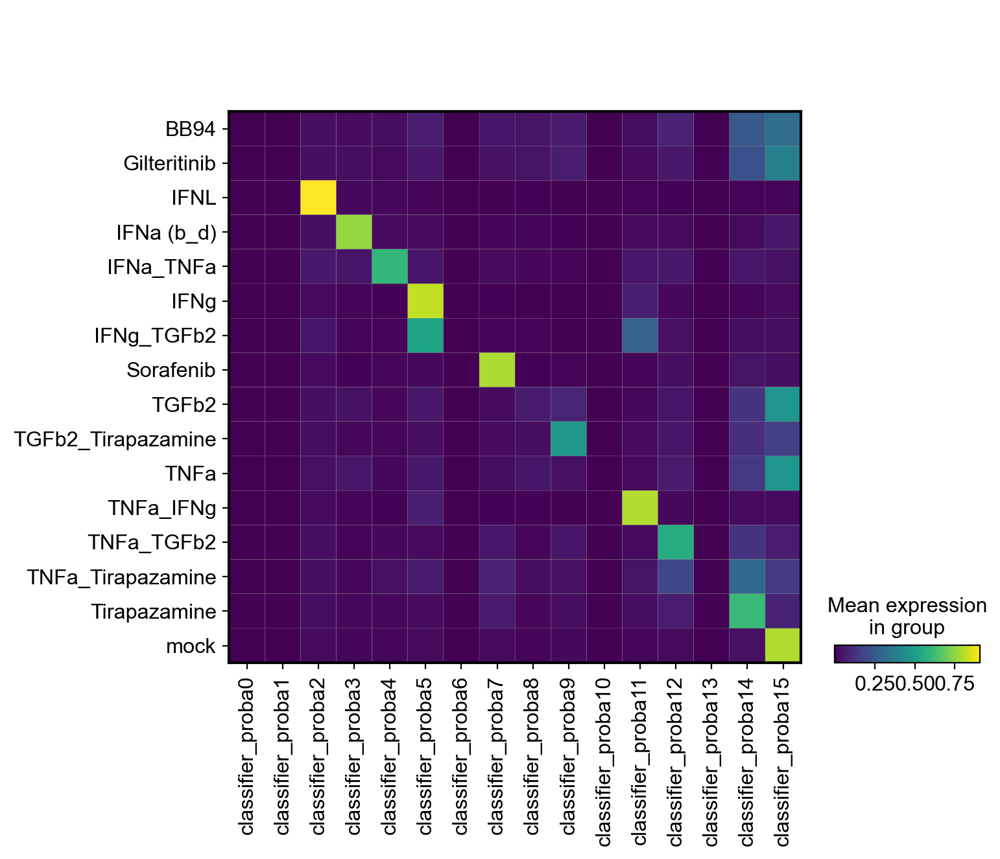

In [268]:
# I'm not sure which classes correspond to which so...
for i in range(preds.shape[1]):
    adata.obs[f'classifier_proba{i}'] = preds[:, i]
sc.pl.matrixplot(adata, var_names=[f'classifier_proba{i}' for i in range(preds.shape[1])], groupby=['treatment'])

Oh... actually it failed to learn some of the conditions, presumably because they were too similar to mock (see similarity in last column), or something else went wrong (not due to sample size). But we've figured out from this plot that the order goes according to `adata.obs.treatment.cat.categories`.

Now let's look how how scoring actually worked out for the fischer dataset.

In [ ]:
for i in range(preds.shape[1]):
    adata.obs[f'classifier_proba_{adata.obs.treatment.cat.categories[i]}'] = preds[:, i]

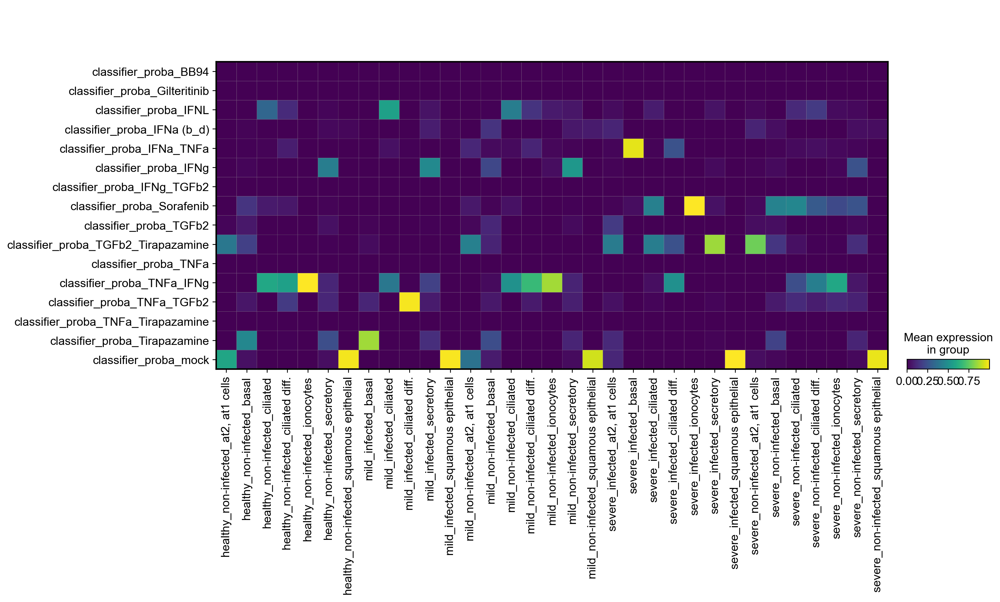

In [296]:
sc.pl.matrixplot(
    adata[adata.obs.batch_data == 'fischer'],
    groupby=['severity_virus', 'cell_type'],
    var_names=[f'classifier_proba_{adata.obs.treatment.cat.categories[i]}' for i in range(preds.shape[1])],
    swap_axes=True
)

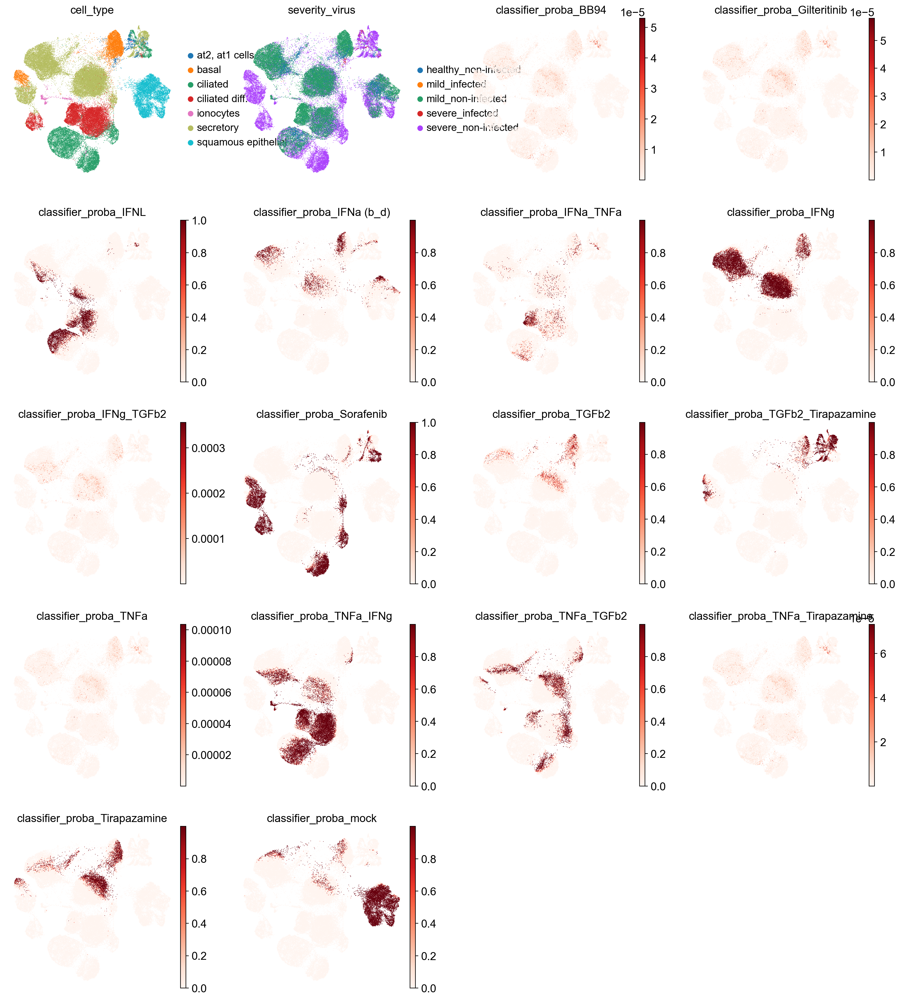

In [293]:
sc.pl.umap(adata[adata.obs.batch_data == 'fischer'], color=['cell_type', 'severity_virus'] + [f'classifier_proba_{adata.obs.treatment.cat.categories[i]}' for i in range(preds.shape[1])])

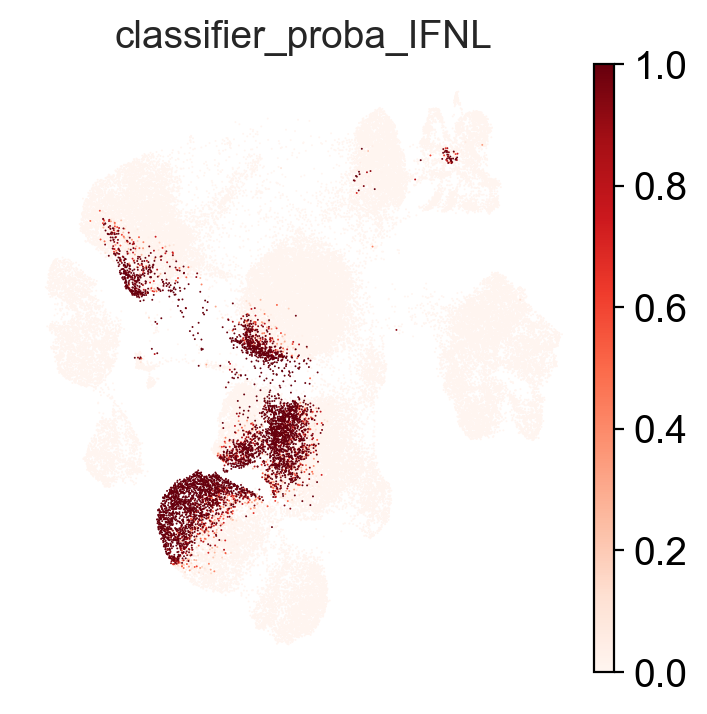

In [321]:
sc.pl.umap(adata[adata.obs.batch_data == 'fischer'], color='classifier_proba_IFNL', color_map='Reds')

Question: what proportions of the phenotypes are occuring in the cell subpopulations?

In [300]:
sc.tl.leiden(adata, key_added='leiden_merge')

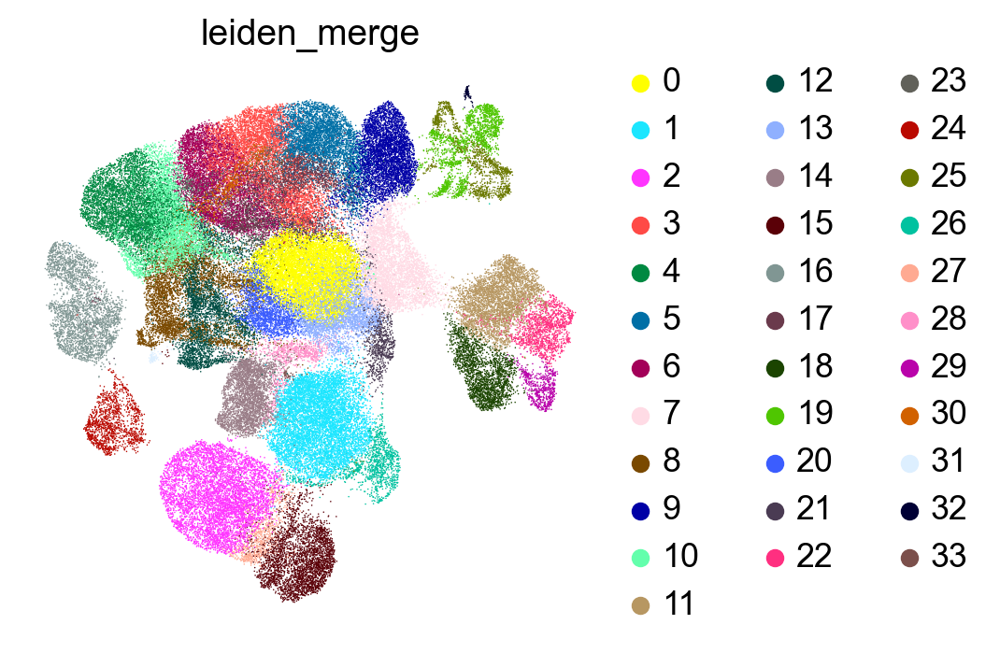

In [301]:
sc.pl.umap(adata, color='leiden_merge')

In [307]:
from sccoda.util import data_visualization as viz
from sccoda.util import cell_composition_data as dat
import anndata as ad

Plot the proportions of each phenotype per cell type in the fischer dataset.

In [ ]:
df_adata = ad.AnnData(pd.crosstab(adata[adata.obs.batch_data == 'fischer'].obs.severity_virus, adata[adata.obs.batch_data == 'fischer'].obs.treatment_predicted))
df_adata.obs = df_adata.obs.reset_index()

g = viz.stacked_barplot(df_adata, feature_name='severity_virus')
g.set_xticklabels(g.get_xticklabels(), rotation=90, ha='right');

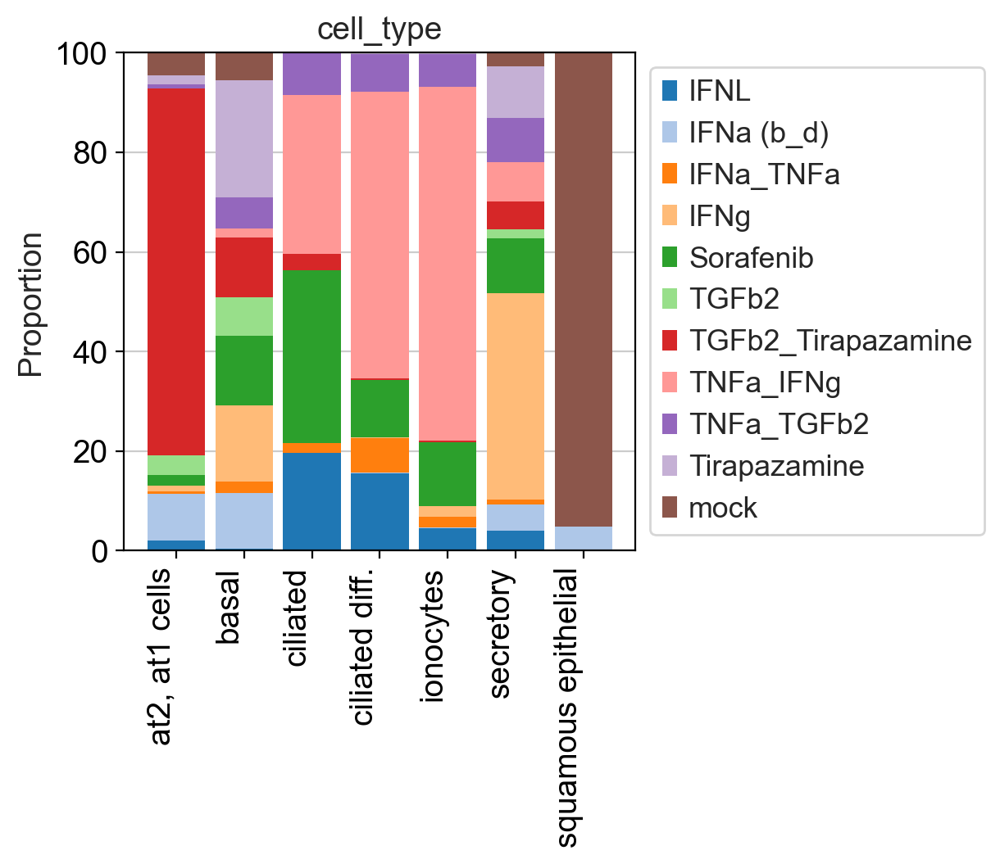

In [325]:
df_adata = ad.AnnData(pd.crosstab(adata[adata.obs.batch_data == 'fischer'].obs.cell_type, adata[adata.obs.batch_data == 'fischer'].obs.treatment_predicted))
df_adata.obs = df_adata.obs.reset_index()

g = viz.stacked_barplot(df_adata, feature_name='cell_type')
g.set_xticklabels(g.get_xticklabels(), rotation=90, ha='right');

Identify which subclusters of cells map to which phenotypes.

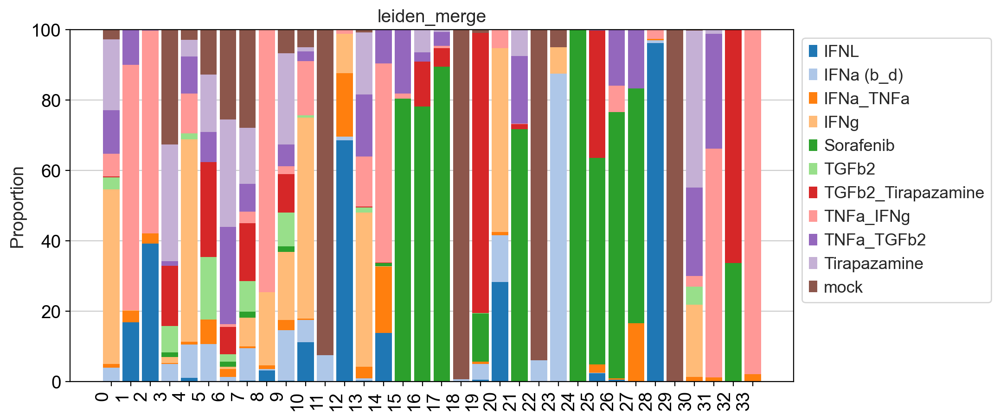

In [332]:
df_adata = ad.AnnData(pd.crosstab(adata[adata.obs.batch_data == 'fischer'].obs.leiden_merge, adata[adata.obs.batch_data == 'fischer'].obs.treatment_predicted))
df_adata.obs = df_adata.obs.reset_index()

g = viz.stacked_barplot(df_adata, feature_name='leiden_merge', figsize=(10, 5))
g.set_xticklabels(g.get_xticklabels(), rotation=90, ha='right');

Map to original leiden clustering, which was not on the IFNL gene set space.

### Feature importance

#### via permutation

Inspired by the implementation proposed in Fisher, Rudin, Dominici (2018) https://arxiv.org/abs/1801.01489

Subsample to reduce runtime, otherwise takes too long.

In [395]:
sc.pp.subsample(adata, .25)

Get the original probabilities for comparison.

In [408]:
z1 = lvae_lr.get_latent_representation(adata)
preds = lvae_lr.module.classifier(torch.from_numpy(z1)).detach().numpy()
for i in range(preds.shape[1]):
    adata.obs[f'classifier_proba_{adata.obs.treatment.cat.categories[i]}'] = preds[:, i]

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/scvi/model/base/_base_model.py:151: UserWarning: Make sure the registered X field in anndata contains unnormalized count data.
  "Make sure the registered X field in anndata contains unnormalized count data."


Set the shuffle indices to be consistent throughout each permutation.

In [396]:
import random
indices = adata.obs.index.values
random.shuffle(indices)

Iteratively switch the values and predict.

In [397]:
perm_values = adata[indices].X
IFNL_values = adata.obs['classifier_proba_IFNL'].values

In [ ]:
%%time
change_mat = []
for i, gene in enumerate(adata.var_names):
    # permute one gene in the adata
    new_adata = adata.copy()
    new_adata.X[:, i] = perm_values[:, i]
    # get prediction probabilities
    z1 = lvae_lr.get_latent_representation(new_adata)
    preds = lvae_lr.module.classifier(torch.from_numpy(z1)).detach().numpy()
    # get difference between new and original probabilities
    change_mat.append(IFNL_values - preds[:, 2])

### Feature correlation during reconstruction

In [335]:
%%time
feat_corr = lvae_lr.get_feature_correlation_matrix(n_samples=2)  # calculating correlations from reconstructed data (aka posterior expression)

CPU times: user 37min 54s, sys: 2min 42s, total: 40min 37s
Wall time: 5min 20s


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/seaborn/matrix.py:649: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


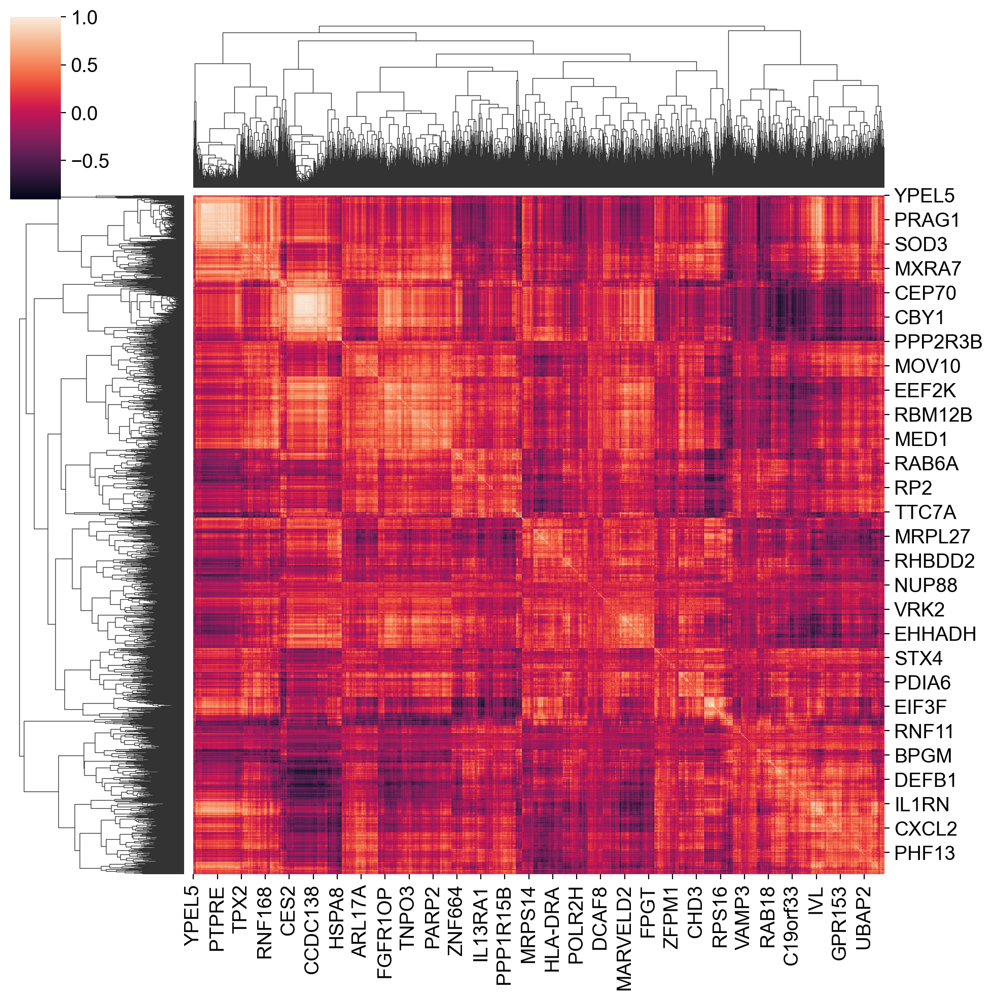

In [337]:
sns.clustermap(feat_corr)

## labeling with DIALOGUE programs

In [4]:
adata = sc.read('/storage/groups/ml01/workspace/yuge.ji/covid-perturbation/data/211005_fischer_integrated.h5ad')

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'severity_virus' as categorical


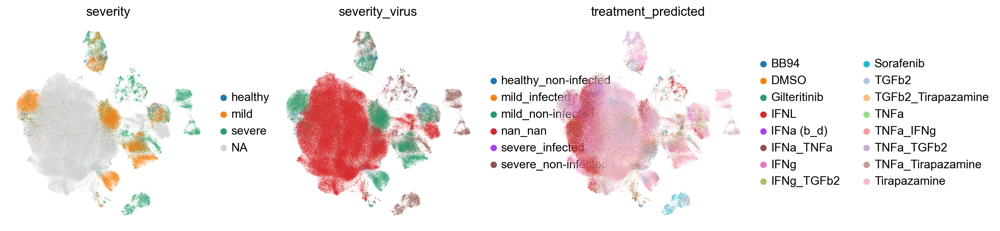

In [6]:
adata.obs['severity_virus'] = adata.obs.severity.astype(str) + '_' + adata.obs.virus_positive.astype(str)
sc.pl.umap(adata, color=['severity', 'severity_virus', 'treatment_predicted'])

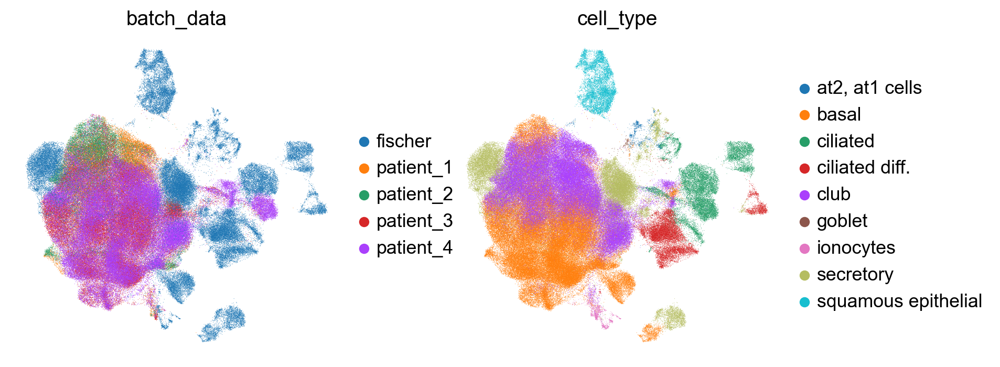

In [7]:
sc.pl.umap(adata, color=['batch_data', 'cell_type'], ncols=3)

In [5]:
import pickle5 as pickle
with open('main_results_dict.pkl', 'rb') as handle:
    dic = pickle.load(handle)

In [11]:
mcp_dict = {}
for k, v in dic.items():
    mcp = sum(list(v.values()), [])
    mcp = set(adata.var_names) & set(mcp)
    mcp_dict[k] = list(mcp)

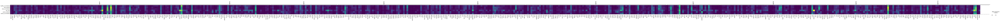

In [12]:
sc.pl.matrixplot(adata, mcp_dict, groupby='severity_virus')

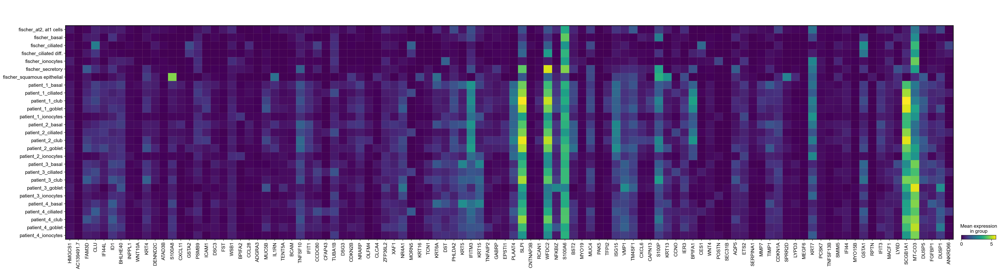

In [17]:
sc.pl.matrixplot(adata, mcp_dict['MCP1'], groupby=['batch_data', 'cell_type'])

What we'd want to see here is a _pattern_ of expression from cell type to cell type that is shared, enough to align both the cell types and which demonstrates that we can align the perturbation effect (as defined by MCP1).

In [ ]:
pd.crosstab(adata.obs.cell_type, adata.obs.)

## Save

In [56]:
sc.write('/storage/groups/ml01/workspace/yuge.ji/covid-perturbation/data/211005_fischer_integrated.h5ad', adata)

In [57]:
lvae.save('2021-10-10_scanvi_lvae_patient_fischer_labels')